In [121]:
# Import necessary packages
from IPython.display import HTML, Image
import numpy as np
import pandas as pd
import time
import math
import statistics
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from skimage import data
from sklearn import datasets
import seaborn as sns; sns.set()

# Reading in County Data and Creating Rates

In [122]:
Counties = pd.read_csv('~/desktop/crime_data.csv') #Reads in crime data at the county level

In [123]:
pd.set_option('max_columns', None)
pd.set_option('max_rows', None)
#Counties

In [124]:
# A second dataframe was created since the original dataframe without counties as the index 
# were used to create the states dataframe. Doing this allows for the states dataframe to not 
# have to be reconstructed.

Counties2 = Counties.set_index('county_name')
#Counties2

In [125]:
def rate(v, name):
    '''Function takes in a column of raw crime values for each county and the name of that column and returns 
    the crime rate for all counties.'''
    
    if np.isscalar(v) == True or type(name) != str:
        
        raise(TypeError('The first input must be scriptable and the second must be a string.'))
        
    vec = []
    
    for i in range(len(v)):
        
        r = (100_000*Counties2[name][i])/Counties2['population'][i]
        
        vec.append(r)
        
    return vec

In [126]:
#list of crime types to use in functions.
CRIMES = ['MURDER', 'RAPE', 'ROBBERY', 'AGASSLT', 'BURGLRY', 'LARCENY', 'MVTHEFT', 'ARSON']

Crimes = ['Murder', 'Rape', 'Robbery', 'Agasslt', 'Burglry', 'Larceny', 'Mvtheft', 'Arson']

In [127]:
def create_c_r(v):
    '''Takes in a list of crimes and creates rates using the "rate" function and then inserts them into 
    the dataframe "counties".'''
    
    if np.isscalar(v) == True:
        
        raise(TypeError('The input must be scriptable.'))
        
    i = 0
    while i < len(v):
        
        Counties2.insert(13 + 2*i, f"{v[i]}_RATE", rate(Counties2[v[i]], v[i]), True)
        i = i + 1

In [128]:
create_c_r(CRIMES)

Following code isolates the specific crime, population, and county data for each row.

In [129]:
def isolate_c_r(v):
    '''Creates a list of arrays which contains the full analysis for each type of crime.'''
    
    if np.isscalar(v) == True:
        
        raise(TypeError('The input must be scriptable.'))
    
    i = 0
    j = 0
    vec3 = []
    while i < len(v):
        vec = Counties2.sort_values(by=[f'{v[i]}_RATE'], ascending=False)
        
        vec2 = vec.iloc[:, [0, 12+ 2*i, 13+2*i, 28]]
        i = i + 1
        
        vec3.append(vec2)

    return vec3

In [130]:
#List of Arrays containing the county level analysis.
COUNTY_LEVEL_ANALYSIS = isolate_c_r(CRIMES)

In [131]:
#Counties2

# Creating States Dataframe

In [132]:
y = pd.Series({'AK': 0, 'AL': 0, 'AK': 0, 'AZ': 0, 'AR': 0, 'CA': 0, 'CO': 0, 'CT': 0, 'DE': 0, 
                              'FL': 0, 'GA': 0, 'HI': 0, 'ID': 0, 'IL': 0, 'IN': 0, 'IA': 0, 'KS': 0, 'KY': 0,
                              'LA': 0, 'ME': 0, 'MD': 0, 'MA': 0, 'MI': 0, 'MN': 0, 'MS': 0, 'MO': 0, 'MT': 0,
                              'NE': 0, 'NV': 0, 'NH': 0, 'NJ': 0, 'NM': 0, 'NY': 0, 'NC': 0, 'ND': 0, 'OH': 0,
                              'OK': 0, 'OR': 0, 'PA': 0, 'RI': 0, 'SC': 0, 'SD': 0, 'TN': 0, 'TX': 0, 'UT': 0, 
                              'VT': 0, 'VA': 0, 'WA': 0, 'WV': 0, 'WI': 0, 'WY': 0})
#Construction of states dataframe.
Total_Population = y
Murder = y
Murder_Rate = y
Rape = y
Rape_Rate = y
Robbery = y
Robbery_Rate = y
Agasslt = y
Agasslt_Rate = y
Burglry = y
Burglry_Rate = y
Larceny = y
Larceny_Rate = y
Mvtheft = y
Mvtheft_Rate = y
Arson = y
Arson_Rate = y

# create a dataframe by indicating the key, then the value
states = pd.DataFrame({'Total Population':Total_Population, 'Murder':Murder, 'Murder Rate':Murder_Rate, 'Rape':Rape,
                       'Rape Rate':Rape_Rate, 'Robbery':Robbery, 'Robbery Rate':Robbery_Rate, 'Agasslt':Agasslt,
                       'Agasslt Rate':Agasslt_Rate, 'Burglry':Burglry, 'Burglry Rate': Burglry_Rate, 'Larceny':Larceny,
                       'Larceny Rate':Larceny_Rate, 'Mvtheft':Mvtheft, 'Mvtheft Rate':Mvtheft_Rate, 'Arson':Arson,
                       'Arson Rate': Arson_Rate})

In [133]:
def get_states(v):
    '''Adds a space in front of each state initial so that the strings match the Counties df.'''
    
    if np.isscalar(v) == True:
        
        raise(TypeError('The input must be scriptable.'))
    
    vec = []
    for row in v.index:
        s = ' '+ row
        vec.append(s)
    return vec

In [134]:
s_n = get_states(states)

In [135]:
#Splits city and state in location column in Counties.
u_state = Counties['county_name'].str.split(",", n = 1, expand = True)

In [136]:
def state_pop(v):
    '''Adds up all the state population based off the counties.'''
    
    if np.isscalar(v) == True:
        
        raise(TypeError('The input must be scriptable.'))
    
    vec = []
    for i in range(len(s_n)):
        Total = 0
        for j in range(len(Counties)):
            
            if s_n[i] == v[1][j]:
                t = Counties['population'][j]
            
                Total = Total + t
                
        vec.append(Total)
            
    return vec

In [137]:
states['Total Population'] = state_pop(u_state)

In [138]:
def state_crimes(v, name):
    '''Adds up the total number of raw crimes for each specific type of crime by state.'''
    
    if np.isscalar(v) == True or type(name) != str:
        
        raise(TypeError('The first input must be scriptable and the second must be a string.'))
    
    vec = []
    for i in range(len(s_n)):
        Total = 0
        for j in range(len(Counties)):
            
            if s_n[i] == v[1][j]:
                t = Counties[name][j]
            
                Total = Total + t
                
        vec.append(Total)
            
    return vec

In [139]:
def state_rate(v, name):
    '''Uses raw totals and populations to create rates or each type of crime in each state.'''
    
    if np.isscalar(v) == True or type(name) != str:
        
        raise(TypeError('The first input must be scriptable and the second must be a string.'))
    
    vec = []
    for i in range(len(states)):
        r = (100_000*states[name][i])/states['Total Population'][i]
        
        vec.append(r)
        
    return vec

In [140]:
def create_crime_columns(v, v2):
    '''Constructs all raw and rate crime numbers for the states dataframe.'''
    
    if np.isscalar(v) == True or np.isscalar(v2) == True:
        
        raise(TypeError('Both inputs must be scriptable.'))
    
    vec = []
    i = 0
    vec2 = []
    j = 0
    while i < len(v):
        
        states[v[i]] = state_crimes(u_state, v2[i])
        i = i + 1
    while j < len(v2):
        
        states[f'{v[j]} Rate'] = state_rate(u_state, v[j])
        j = j + 1

In [141]:
create_crime_columns(Crimes, CRIMES)

In [142]:
states

,Total Population,Murder,Murder Rate,Rape,Rape Rate,Robbery,Robbery Rate,Agasslt,Agasslt Rate,Burglry,Burglry Rate,Larceny,Larceny Rate,Mvtheft,Mvtheft Rate,Arson,Arson Rate
AK,718165,21,2.924119,439,61.128014,591,82.293066,2351,327.362096,1781,247.993149,13346,1858.347316,1223,170.295127,136,18.937152
AL,4833722,341,7.054605,1283,26.542693,4988,103.191702,14857,307.361491,46928,970.846069,109949,2274.623985,9757,201.852734,1025,21.205191
AZ,6626624,325,4.904458,1725,26.031355,7263,109.603321,16638,251.078075,50486,761.866072,130487,1969.132397,17683,266.847795,1405,21.202350
AR,2959373,173,5.845833,1219,41.191158,2302,77.786747,10032,338.990725,32300,1091.447411,70327,2376.415545,5652,190.986402,564,19.058091
CA,38332521,1879,4.901843,7826,20.416085,56484,147.352688,94420,246.318263,245558,640.599662,634550,1655.382906,168515,439.613664,7395,19.291713
CO,5268367,152,2.885144,2106,39.974436,3372,64.004653,10161,192.868113,25796,489.639389,99295,1884.739617,11973,227.262072,909,17.253923
CT,3596080,109,3.031078,876,24.359859,3636,101.110098,5212,144.935597,13447,373.934951,52794,1468.098596,6154,171.130787,324,9.009811
DE,925749,56,6.049156,249,26.897140,1498,161.814920,3245,350.526979,7390,798.272534,21882,2363.707657,1438,155.333681,226,24.412665
FL,19552860,1009,5.160370,5251,26.855406,23836,121.905440,63801,326.300091,153262,783.834181,440437,2252.545152,37203,190.268840,1747,8.934754
GA,9992167,583,5.834570,2118,21.196603,12384,123.937080,22126,221.433449,85888,859.553288,220545,2207.178883,28373,283.952420,1213,12.139509


In [143]:
states['Total Population']['CA']

38332521

In [144]:
def isolate_s_r(v):
    '''Creates a list of arrays which contains the full analysis for each type of crime.'''
    
    if np.isscalar(v) == True:
        
        raise(TypeError('The input must be scriptable.'))
    
    i = 0
    vec3 = []
    while i < len(v):
        vec = states.sort_values(by=[f'{v[i]} Rate'], ascending=False)
        
        vec2 = vec.iloc[:, [0,1+2*i,2+2*i]]
        i = i + 1
        
        vec3.append(vec2)

    return vec3

In [145]:
#List of arrays containing the state level crime analysis.
STATE_LEVEL_ANALYSIS = isolate_s_r(Crimes)

# Creating State and County Classes

In [146]:
class State:
    """Creates a state object representing a state's crime data."""
    
    def __init__ (self, states, name= '', Population = 0 , Murder = 0, Rape = 0, Robbery = 0, Agasslt = 0, Burglry = 0, Larceny = 0, Mvtheft = 0, Arson = 0):
        self.name = name
        self.Population = Population
        self.Murder = Murder
        self.Rape = Rape
        self.Robbery = Robbery
        self.Agasslt = Agasslt
        self.Burglry = Burglry
        self.Larceny = Larceny
        self.Mvtheft = Mvtheft
        self.Arson = Arson
        
        
    def print_state(self):
        print(f'{self.name} data:')
        print(f'Population: {states["Total Population"][self.name]}')
        print(f'Total Murders: {states["Murder"][self.name]}')
        print(f'Total Rapes: {states["Rape"][self.name]}')
        print(f'Total Robbery: {states["Robbery"][self.name]}')
        print(f'Total Agasslt: {states["Agasslt"][self.name]}')
        print(f'Total Burglry: {states["Burglry"][self.name]}')
        print(f'Total Larceny: {states["Larceny"][self.name]}')
        print(f'Total Mvtheft: {states["Mvtheft"][self.name]}')
        print(f'Total Arson: {states["Arson"][self.name]}')
        
    def __str__(self):
        return f'{self.name} data:\nPopulation: {states["Total Population"][self.name]}\nTotal Murders: {states["Murder"][self.name]}\nTotal Rapes: {states["Rape"][self.name]}\nTotal Robberies:{states["Robbery"][self.name]}\nTotal Agasslt:{states["Agasslt"][self.name]}\nTotal Burglry:{states["Burglry"][self.name]}\nTotal Larceny:{states["Larceny"][self.name]}\nTotal Mvtheft:{states["Mvtheft"][self.name]}\nTotal Arson:{states["Arson"][self.name]}'    
        
    def rate(self):
        print(f'{self.name} rate data:')
        m_r = (100_000*states['Murder'][self.name]/states['Total Population'][self.name])
        print(f'Murder Rate: {m_r}')
        r_r = (100_000*states['Rape'][self.name]/states['Total Population'][self.name])
        print(f'Rape Rate: {r_r}')
        ro_r = (100_000*states['Robbery'][self.name]/states['Total Population'][self.name])
        print(f'Robbery Rate: {ro_r}')
        a_r = (100_000*states['Agasslt'][self.name]/states['Total Population'][self.name])
        print(f'Aggravated Assault Rate: {a_r}')
        b_r = (100_000*states['Burglry'][self.name]/states['Total Population'][self.name])
        print(f'Burglary Rate: {b_r}')
        l_r = (100_000*states['Larceny'][self.name]/states['Total Population'][self.name])
        print(f'Larceny Rate: {l_r}')
        mv_r = (100_000*states['Mvtheft'][self.name]/states['Total Population'][self.name])
        print(f'Motor Theft Rate: {mv_r}')
        ar_r = (100_000*states['Arson'][self.name]/states['Total Population'][self.name])
        print(f'Arson Rate: {ar_r}')

In [147]:
class County:
    """Creates a county object representing a county's crime data."""
    
    def __init__ (self, Counties2, name= '', Population = 0 , Murder = 0, Rape = 0, Robbery = 0, Agasslt = 0, Burglry = 0, Larceny = 0, Mvtheft = 0, Arson = 0):
        self.name = name
        self.Population = Population
        self.Murder = Murder
        self.Rape = Rape
        self.Robbery = Robbery
        self.Agasslt = Agasslt
        self.Burglry = Burglry
        self.Larceny = Larceny
        self.Mvtheft = Mvtheft
        self.Arson = Arson
        
    def print_county(self):
        print(f'{self.name} data:')
        print(f'Population: {Counties2["population"][self.name]}')
        print(f'Total Murders: {Counties2["MURDER"][self.name]}')
        print(f'Total Rapes: {Counties2["RAPE"][self.name]}')
        print(f'Total Robbery: {Counties2["ROBBERY"][self.name]}')
        print(f'Total Aggravated Assault: {Counties2["AGASSLT"][self.name]}')
        print(f'Total Burglary: {Counties2["BURGLRY"][self.name]}')
        print(f'Total Larceny: {Counties2["LARCENY"][self.name]}')
        print(f'Total Motor theft: {Counties2["MVTHEFT"][self.name]}')
        print(f'Total Arson: {Counties2["ARSON"][self.name]}')
        
    def __str__(self):
        return f'{self.name} data:\nPopulation: {Counties2["population"][self.name]}\nTotal Murders: {Counties2["MURDER"][self.name]}\nTotal Rapes: {Counties2["RAPE"][self.name]}\nTotal Robberies: {Counties2["ROBBERY"][self.name]}\nTotal Aggravated Assault: {Counties2["AGASSLT"][self.name]}\nTotal Burglary: {Counties2["BURGLRY"][self.name]}\nTotal Larceny: {Counties2["LARCENY"][self.name]}\nTotal Motor Theft: {Counties2["MVTHEFT"][self.name]}\nTotal Arson: {Counties2["ARSON"][self.name]}'
    
    def rate(self):
        print(f'{self.name} rate data:')
        m_r = (100_000*Counties2['MURDER'][self.name]/Counties2['population'][self.name])
        print(f'Murder Rate: {m_r}')
        r_r = (100_000*Counties2['RAPE'][self.name]/Counties2['population'][self.name])
        print(f'Rape Rate: {r_r}')
        ro_r = (100_000*Counties2['ROBBERY'][self.name]/Counties2['population'][self.name])
        print(f'Robbery Rate: {ro_r}')
        a_r = (100_000*Counties2['AGASSLT'][self.name]/Counties2['population'][self.name])
        print(f'Aggravated Assault Rate: {a_r}')
        b_r = (100_000*Counties2['BURGLRY'][self.name]/Counties2['population'][self.name])
        print(f'Burglary Rate: {b_r}')
        l_r = (100_000*Counties2['LARCENY'][self.name]/Counties2['population'][self.name])
        print(f'Larceny Rate: {l_r}')
        mv_r = (100_000*Counties2['MVTHEFT'][self.name]/Counties2['population'][self.name])
        print(f'Motor Theft Rate: {mv_r}')
        ar_r = (100_000*Counties2['ARSON'][self.name]/Counties2['population'][self.name])
        print(f'Arson Rate: {ar_r}')

In [148]:
LA = County(Counties2, 'Los Angeles County, CA')
LA.rate()

Los Angeles County, CA rate data:
Murder Rate: 5.98977664921512
Rape Rate: 19.726331098081793
Robbery Rate: 188.90757255516286
Aggravated Assault Rate: 230.177133668255
Burglary Rate: 490.2332698550115
Larceny Rate: 1423.6101821411216
Motor Theft Rate: 404.858986681532
Arson Rate: 22.06234399127569


In [149]:
CA = State(states, 'CA')
CA.rate()

CA rate data:
Murder Rate: 4.901843006881807
Rape Rate: 20.41608481738
Robbery Rate: 147.3526878130452
Aggravated Assault Rate: 246.31826328354455
Burglary Rate: 640.5996620989264
Larceny Rate: 1655.3829058099257
Motor Theft Rate: 439.6136638130323
Arson Rate: 19.291713164391144


# Creating Visualizations for State Data

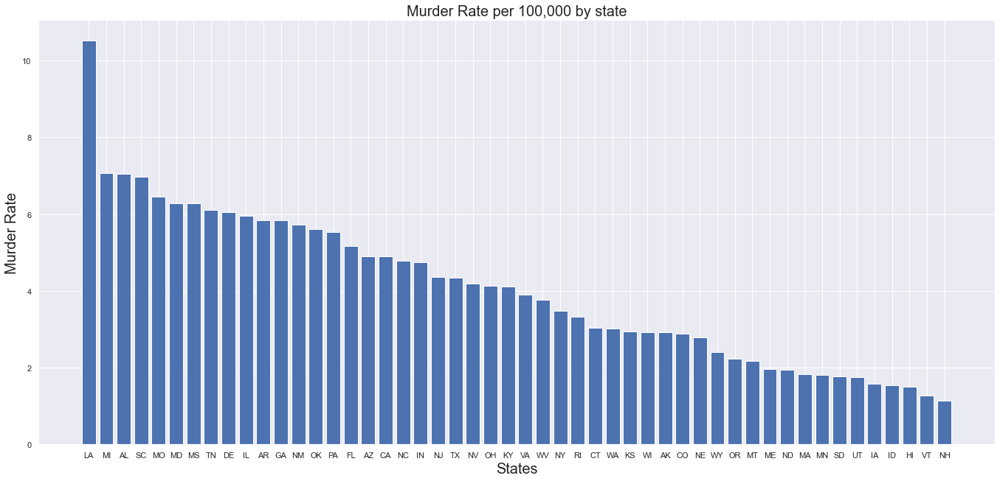

In [150]:
X = STATE_LEVEL_ANALYSIS[0].index
y = STATE_LEVEL_ANALYSIS[0]['Murder Rate']

fig = plt.figure()
ax = fig.add_axes([0,0,3,2])
ax.bar(X,y)

plt.title('Murder Rate per 100,000 by state', fontsize=20)
plt.xlabel('States', fontsize=20)
plt.ylabel('Murder Rate', fontsize=20)

plt.show()

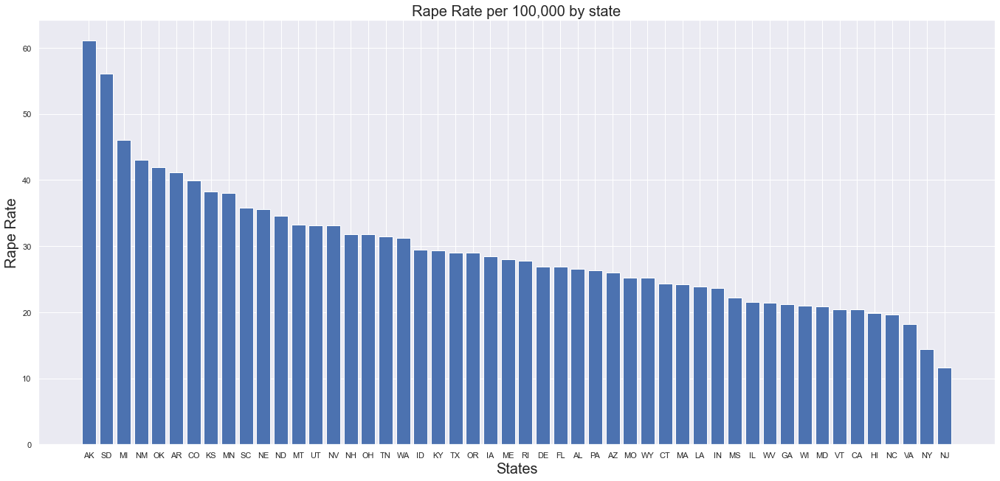

In [151]:
X = STATE_LEVEL_ANALYSIS[1].index
y = STATE_LEVEL_ANALYSIS[1]['Rape Rate']

fig = plt.figure()
ax = fig.add_axes([0,0,3,2])
ax.bar(X,y)

plt.title('Rape Rate per 100,000 by state', fontsize=20)
plt.xlabel('States', fontsize=20)
plt.ylabel('Rape Rate', fontsize=20)

plt.show()

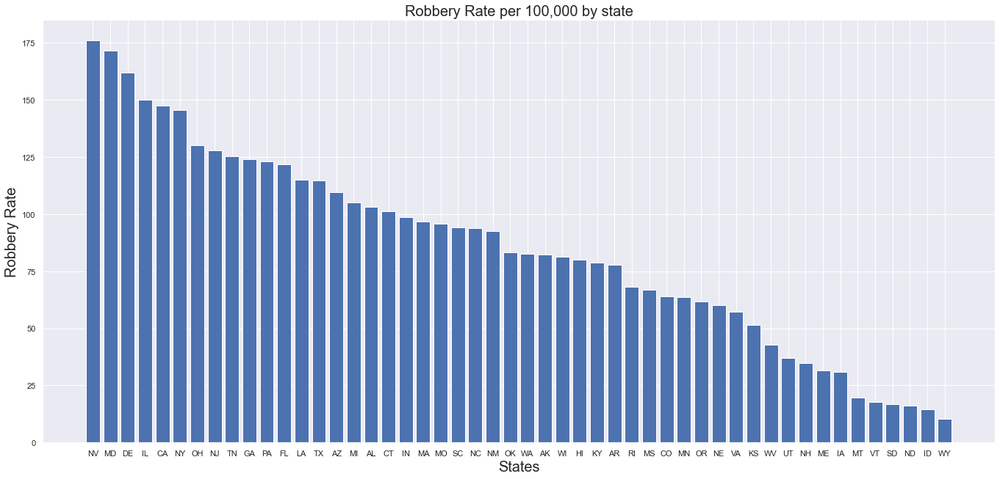

In [152]:
X = STATE_LEVEL_ANALYSIS[2].index
y = STATE_LEVEL_ANALYSIS[2]['Robbery Rate']

fig = plt.figure()
ax = fig.add_axes([0,0,3,2])
ax.bar(X,y)

plt.title('Robbery Rate per 100,000 by state', fontsize=20)
plt.xlabel('States', fontsize=20)
plt.ylabel('Robbery Rate', fontsize=20)

plt.show()

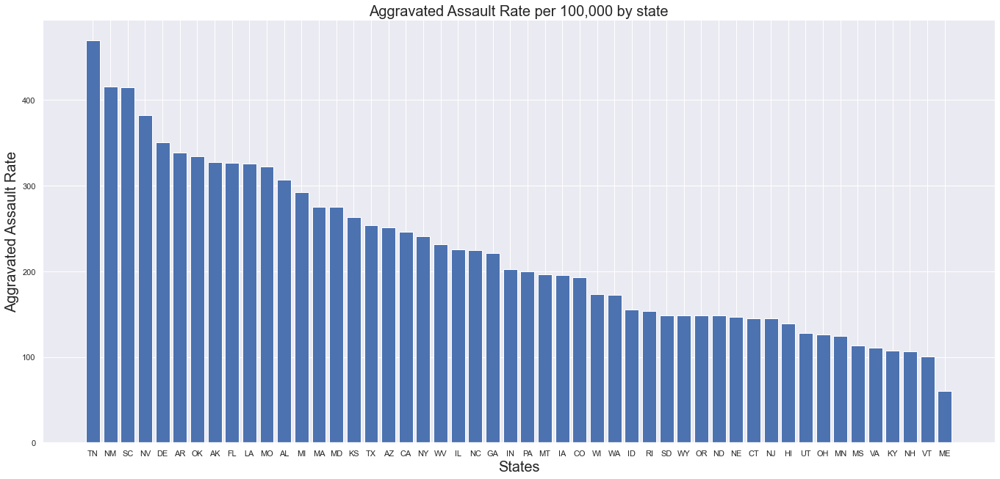

In [153]:
X = STATE_LEVEL_ANALYSIS[3].index
y = STATE_LEVEL_ANALYSIS[3]['Agasslt Rate']

fig = plt.figure()
ax = fig.add_axes([0,0,3,2])
ax.bar(X,y)

plt.title('Aggravated Assault Rate per 100,000 by state', fontsize=20)
plt.xlabel('States', fontsize=20)
plt.ylabel('Aggravated Assault Rate', fontsize=20)

plt.show()

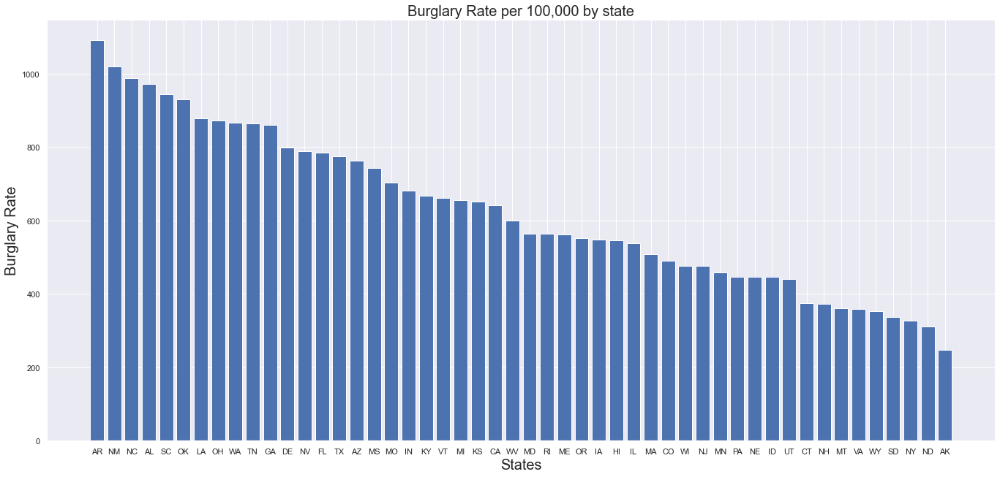

In [154]:
X = STATE_LEVEL_ANALYSIS[4].index
y = STATE_LEVEL_ANALYSIS[4]['Burglry Rate']

fig = plt.figure()
ax = fig.add_axes([0,0,3,2])
ax.bar(X,y)

plt.title('Burglary Rate per 100,000 by state', fontsize=20)
plt.xlabel('States', fontsize=20)
plt.ylabel('Burglary Rate', fontsize=20)

plt.show()

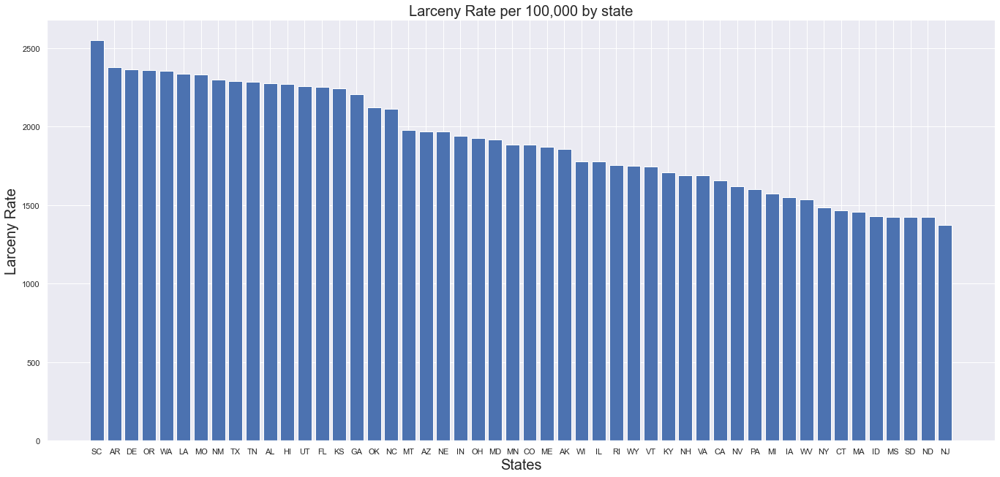

In [155]:
X = STATE_LEVEL_ANALYSIS[5].index
y = STATE_LEVEL_ANALYSIS[5]['Larceny Rate']

fig = plt.figure()
ax = fig.add_axes([0,0,3,2])
ax.bar(X,y)

plt.title('Larceny Rate per 100,000 by state', fontsize=20)
plt.xlabel('States', fontsize=20)
plt.ylabel('Larceny Rate', fontsize=20)

plt.show()

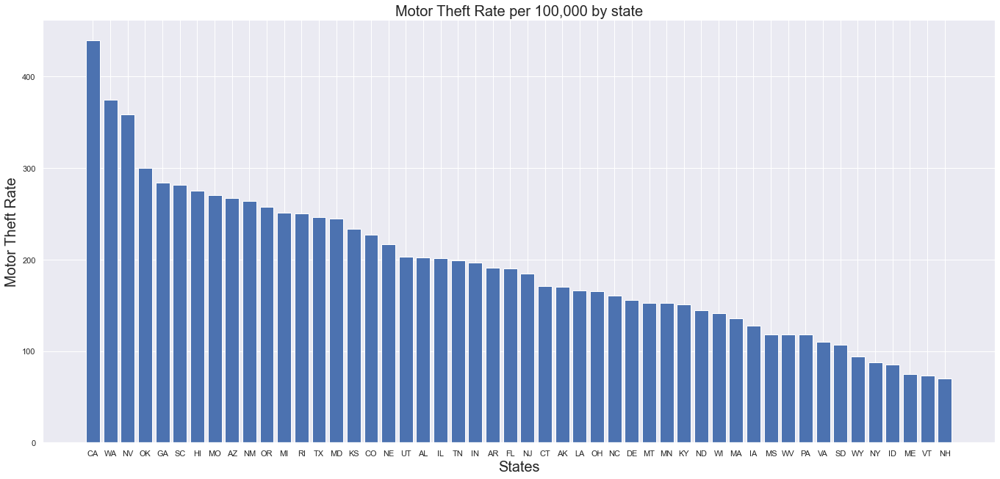

In [156]:
X = STATE_LEVEL_ANALYSIS[6].index
y = STATE_LEVEL_ANALYSIS[6]['Mvtheft Rate']

fig = plt.figure()
ax = fig.add_axes([0,0,3,2])
ax.bar(X,y)

plt.title('Motor Theft Rate per 100,000 by state', fontsize=20)
plt.xlabel('States', fontsize=20)
plt.ylabel('Motor Theft Rate', fontsize=20)

plt.show()

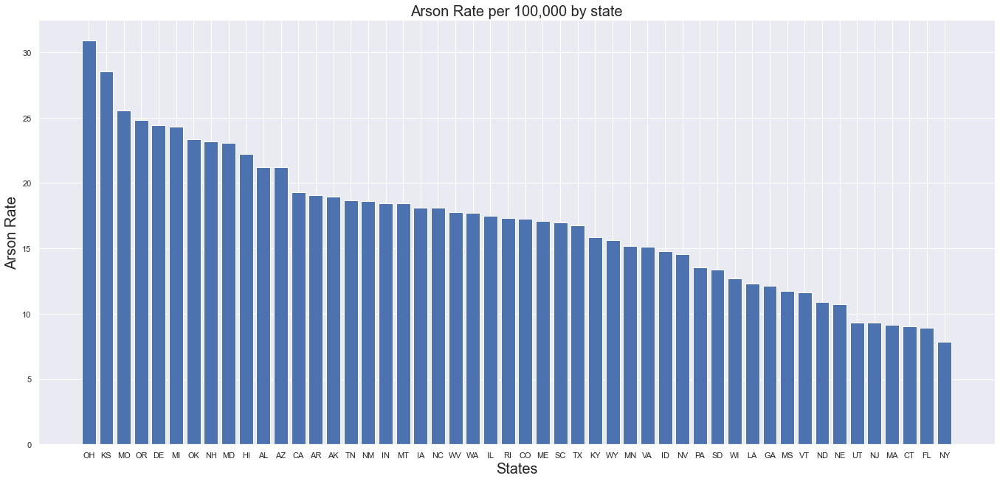

In [157]:
X = STATE_LEVEL_ANALYSIS[7].index
y = STATE_LEVEL_ANALYSIS[7]['Arson Rate']

fig = plt.figure()
ax = fig.add_axes([0,0,3,2])
ax.bar(X,y)

plt.title('Arson Rate per 100,000 by state', fontsize=20)
plt.xlabel('States', fontsize=20)
plt.ylabel('Arson Rate', fontsize=20)

plt.show()

# Creating Visualizations for County Data

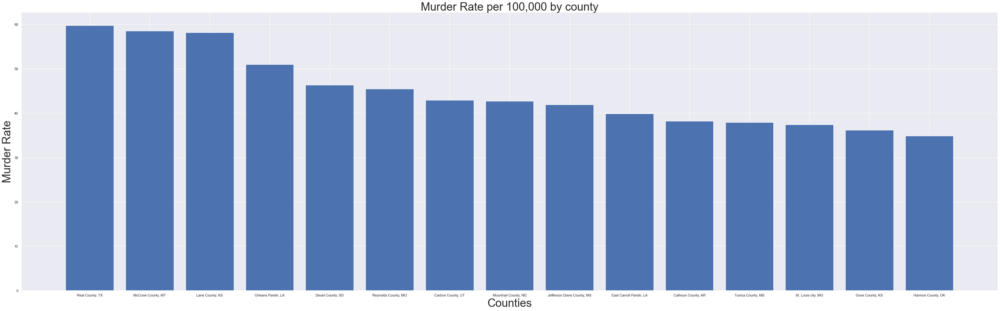

In [158]:
t = COUNTY_LEVEL_ANALYSIS[0].iloc[:15, -15:]

X = t.index
y = t['MURDER_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,7,3])
ax.bar(X,y)

plt.title('Murder Rate per 100,000 by county', fontsize=35)
plt.xlabel('Counties', fontsize=35)
plt.ylabel('Murder Rate', fontsize=35)

plt.show()

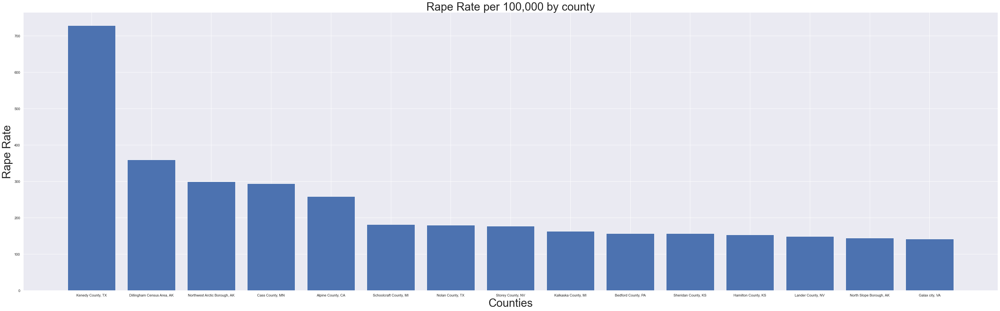

In [159]:
t = COUNTY_LEVEL_ANALYSIS[1].iloc[:15, -15:]

X = t.index
y = t['RAPE_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,7,3])
ax.bar(X,y)

plt.title('Rape Rate per 100,000 by county', fontsize=35)
plt.xlabel('Counties', fontsize=35)
plt.ylabel('Rape Rate', fontsize=35)

plt.show()

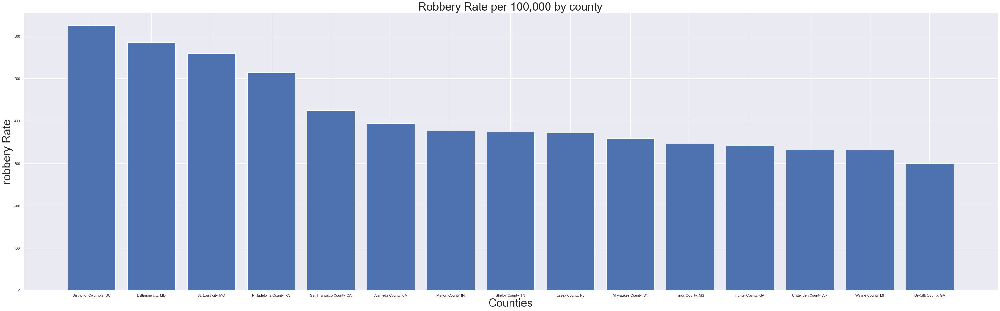

In [160]:
t = COUNTY_LEVEL_ANALYSIS[2].iloc[:15, -15:]

X = t.index
y = t['ROBBERY_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,7,3])
ax.bar(X,y)

plt.title('Robbery Rate per 100,000 by county', fontsize=35)
plt.xlabel('Counties', fontsize=35)
plt.ylabel('robbery Rate', fontsize=35)

plt.show()

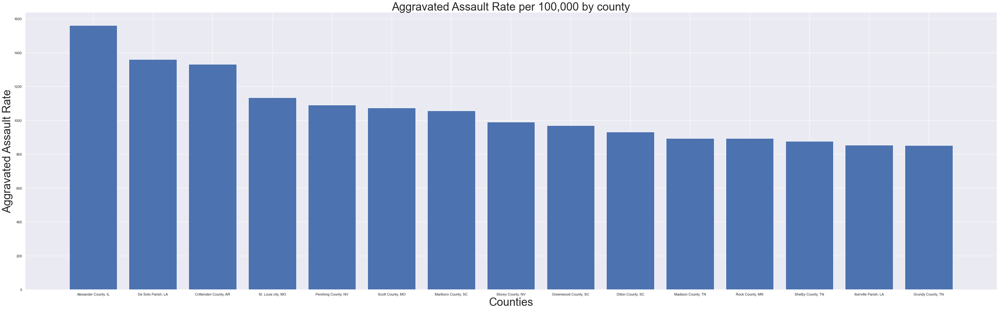

In [161]:
t = COUNTY_LEVEL_ANALYSIS[3].iloc[:15, -15:]

X = t.index
y = t['AGASSLT_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,7,3])
ax.bar(X,y)

plt.title('Aggravated Assault Rate per 100,000 by county', fontsize=35)
plt.xlabel('Counties', fontsize=35)
plt.ylabel('Aggravated Assault Rate', fontsize=35)

plt.show()

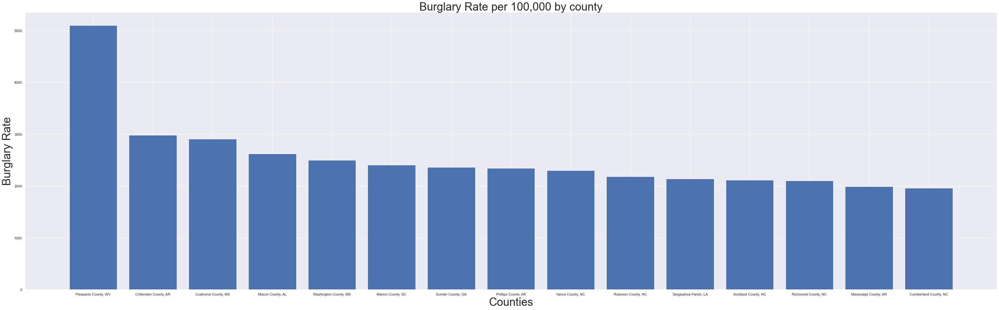

In [162]:
t = COUNTY_LEVEL_ANALYSIS[4].iloc[:15, -15:]

X = t.index
y = t['BURGLRY_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,7,3])
ax.bar(X,y)

plt.title('Burglary Rate per 100,000 by county', fontsize=35)
plt.xlabel('Counties', fontsize=35)
plt.ylabel('Burglary Rate', fontsize=35)

plt.show()

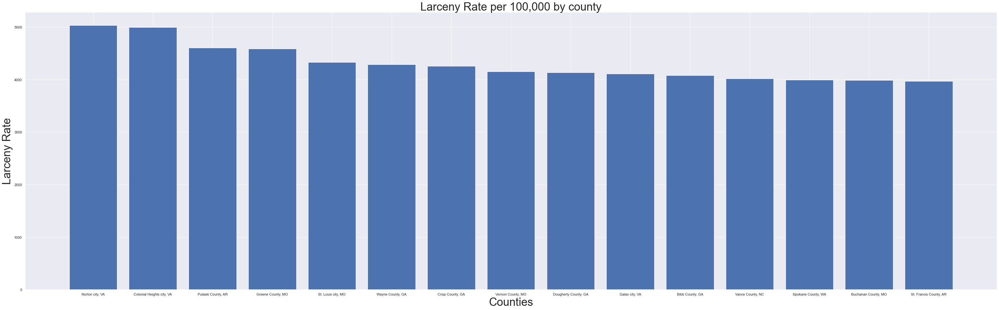

In [163]:
t = COUNTY_LEVEL_ANALYSIS[5].iloc[:15, -15:]

X = t.index
y = t['LARCENY_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,7,3])
ax.bar(X,y)

plt.title('Larceny Rate per 100,000 by county', fontsize=35)
plt.xlabel('Counties', fontsize=35)
plt.ylabel('Larceny Rate', fontsize=35)

plt.show()

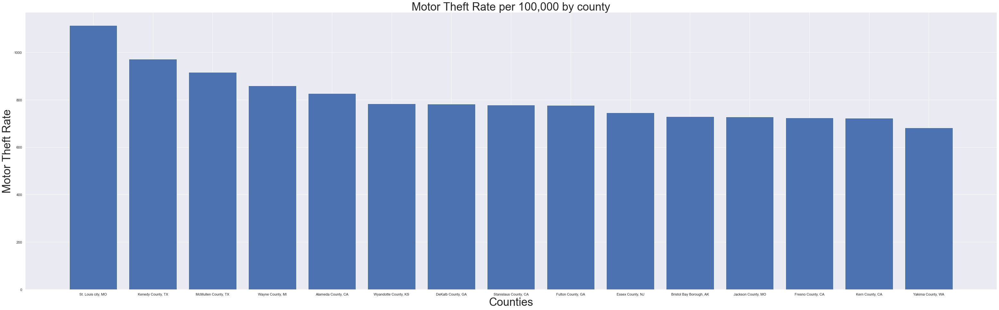

In [164]:
t = COUNTY_LEVEL_ANALYSIS[6].iloc[:15, -15:]

X = t.index
y = t['MVTHEFT_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,7,3])
ax.bar(X,y)

plt.title('Motor Theft Rate per 100,000 by county', fontsize=35)
plt.xlabel('Counties', fontsize=35)
plt.ylabel('Motor Theft Rate', fontsize=35)

plt.show()

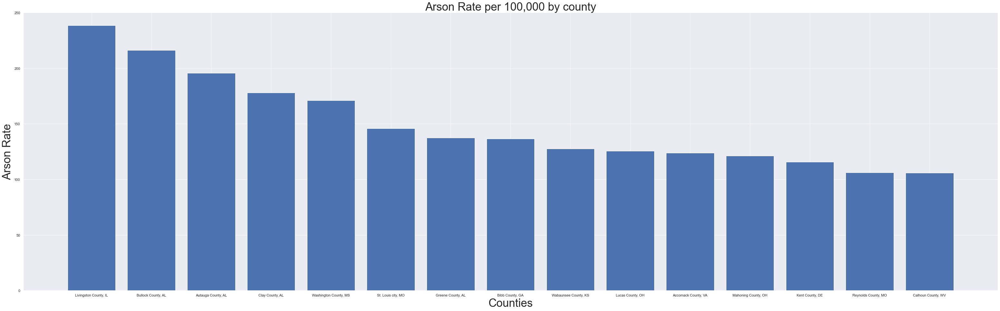

In [165]:
t = COUNTY_LEVEL_ANALYSIS[7].iloc[:15, -15:]

X = t.index
y = t['ARSON_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,7,3])
ax.bar(X,y)

plt.title('Arson Rate per 100,000 by county', fontsize=35)
plt.xlabel('Counties', fontsize=35)
plt.ylabel('Arson Rate', fontsize=35)

plt.show()

# Population Analysis

Counties will be grouped into categories following the below definitions.

| Category | Population Range |
| --- | --- |
| Cat 1 | >500,00 |
| Cat 2 | 500,000 - 100,001 |
| Cat 3 | 100,000 - 50,000 |
| Cat 4 | <50,000 |

In [166]:
 Counties2.insert(29, "Population Category", '')

In [167]:
Counties2

,crime_rate_per_100000,index,EDITION,PART,IDNO,CPOPARST,CPOPCRIM,AG_ARRST,AG_OFF,COVIND,INDEX,MODINDX,MURDER,MURDER_RATE,RAPE,RAPE_RATE,ROBBERY,ROBBERY_RATE,AGASSLT,AGASSLT_RATE,BURGLRY,BURGLRY_RATE,LARCENY,LARCENY_RATE,MVTHEFT,MVTHEFT_RATE,ARSON,ARSON_RATE,population,Population Category,FIPS_ST,FIPS_CTY
county_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"St. Louis city, MO",1791.995377,1,1,4,1612,318667,318667,15,15,100.0000,5706,22329,119,37.372494,200,62.810914,1778,558.389026,3609,1133.422944,4995,1568.702578,13791,4331.126577,3543,1112.695342,464,145.721321,318416,,29,510
"Crittenden County, AR",1754.914968,2,1,4,130,50717,50717,4,4,100.0000,873,3424,8,16.081695,38,76.388051,165,331.684960,662,1330.760262,1482,2979.134001,1753,3523.901419,189,379.930045,28,56.285933,49746,,5,35
"Alexander County, IL",1664.700485,3,1,4,604,8040,8040,2,2,100.0000,127,278,1,13.107878,2,26.215756,5,65.539389,119,1559.837462,82,1074.845982,184,2411.849522,12,157.294534,2,26.215756,7629,,17,3
"Kenedy County, TX",1456.310680,4,1,4,2681,444,444,1,1,100.0000,6,13,0,0.000000,3,728.155340,1,242.718447,2,485.436893,5,1213.592233,4,970.873786,4,970.873786,0,0.000000,412,,48,261
"De Soto Parish, LA",1447.402430,5,1,4,1137,26971,26971,3,3,100.0000,392,703,3,11.077059,4,14.769413,17,62.770003,368,1358.785954,149,550.160617,494,1824.022450,60,221.541188,0,0.000000,27083,,22,31
"Baltimore city, MD",1419.537569,6,1,4,1227,625474,625474,9,9,100.0000,8831,29868,216,34.720883,317,50.956110,3638,584.789681,4660,749.070895,7804,1254.452632,18055,2902.247856,4009,644.426012,251,40.346952,622104,,24,510
"Shelby County, TN",1315.003752,7,1,4,2534,942807,942807,15,14,100.0000,12354,47864,135,14.369881,483,51.412240,3512,373.829786,8224,875.391845,14011,1491.380733,30620,3259.301837,3233,344.132033,435,46.302949,939465,,47,157
"Marlboro County, SC",1253.437132,8,1,4,2377,28780,28780,9,8,100.0000,351,1549,3,10.713138,20,71.420919,32,114.273471,296,1057.029604,408,1456.986751,1074,3835.303360,67,239.260079,5,17.855230,28003,,45,69
"Storey County, NV",1217.656012,9,1,4,1778,3947,3947,1,1,100.0000,48,86,0,0.000000,7,177.574835,2,50.735667,39,989.345510,23,583.460173,55,1395.230847,8,202.942669,2,50.735667,3942,,32,29


In [168]:
def assign_cat(v):
    '''Takes in the population of a county and assigns it a category based on the category defintions previously defined.'''
    
    if np.isscalar(v) == True:
        
        raise(TypeError('The input must be scriptable.'))
        
    vec = []
    
    for i in range(len(v)):
        
        if v['population'][i] > 500_000:
            
            v['Population Category'][i] = 'Cat 1'
            
        if v['population'][i] < 500_000 and v['population'][i] > 100_000:
            
            v['Population Category'][i] = 'Cat 2'
            
        if v['population'][i] < 100_001 and v['population'][i] > 50_000:
            
            v['Population Category'][i] = 'Cat 3'
            
        if v['population'][i] <= 50_000:
            
            v['Population Category'][i] = 'Cat 4'
            
        

In [169]:
assign_cat(Counties2)

/var/folders/sx/qygcfp0s52ngfk4p16xygkf80000gn/T/ipykernel_28301/508790098.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v['Population Category'][i] = 'Cat 2'
/var/folders/sx/qygcfp0s52ngfk4p16xygkf80000gn/T/ipykernel_28301/508790098.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v['Population Category'][i] = 'Cat 4'
/var/folders/sx/qygcfp0s52ngfk4p16xygkf80000gn/T/ipykernel_28301/508790098.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-

In [170]:
def isolate_counties_cat(v):
    '''Creates a list of arrays which contains the full analysis for each type of crime.'''
    
    if np.isscalar(v) == True:
        
        raise(TypeError('The input must be scriptable.'))
    
    vec1 = pd.DataFrame()
    vec2 = pd.DataFrame()
    vec3 = pd.DataFrame()
    vec4 = pd.DataFrame()
    
    for i in range(len(v)):
        
        if v['Population Category'][i] == 'Cat 1':
        
          vec1.append(v.loc[[v.index[i]]])
            
        if v['Population Category'][i] == 'Cat 2':
        
          vec2.append(v.loc[[v.index[i]]])
            
        if v['Population Category'][i] == 'Cat 3':
        
          vec3.append(v.loc[[v.index[i]]])
            
        if v['Population Category'][i] == 'Cat 4':
        
          vec4.append(v.loc[[v.index[i]]])
        
        vec5 = [vec1, vec2, vec3, vec4]

    return vec1

In [171]:
Counties2

,crime_rate_per_100000,index,EDITION,PART,IDNO,CPOPARST,CPOPCRIM,AG_ARRST,AG_OFF,COVIND,INDEX,MODINDX,MURDER,MURDER_RATE,RAPE,RAPE_RATE,ROBBERY,ROBBERY_RATE,AGASSLT,AGASSLT_RATE,BURGLRY,BURGLRY_RATE,LARCENY,LARCENY_RATE,MVTHEFT,MVTHEFT_RATE,ARSON,ARSON_RATE,population,Population Category,FIPS_ST,FIPS_CTY
county_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"St. Louis city, MO",1791.995377,1,1,4,1612,318667,318667,15,15,100.0000,5706,22329,119,37.372494,200,62.810914,1778,558.389026,3609,1133.422944,4995,1568.702578,13791,4331.126577,3543,1112.695342,464,145.721321,318416,Cat 2,29,510
"Crittenden County, AR",1754.914968,2,1,4,130,50717,50717,4,4,100.0000,873,3424,8,16.081695,38,76.388051,165,331.684960,662,1330.760262,1482,2979.134001,1753,3523.901419,189,379.930045,28,56.285933,49746,Cat 4,5,35
"Alexander County, IL",1664.700485,3,1,4,604,8040,8040,2,2,100.0000,127,278,1,13.107878,2,26.215756,5,65.539389,119,1559.837462,82,1074.845982,184,2411.849522,12,157.294534,2,26.215756,7629,Cat 4,17,3
"Kenedy County, TX",1456.310680,4,1,4,2681,444,444,1,1,100.0000,6,13,0,0.000000,3,728.155340,1,242.718447,2,485.436893,5,1213.592233,4,970.873786,4,970.873786,0,0.000000,412,Cat 4,48,261
"De Soto Parish, LA",1447.402430,5,1,4,1137,26971,26971,3,3,100.0000,392,703,3,11.077059,4,14.769413,17,62.770003,368,1358.785954,149,550.160617,494,1824.022450,60,221.541188,0,0.000000,27083,Cat 4,22,31
"Baltimore city, MD",1419.537569,6,1,4,1227,625474,625474,9,9,100.0000,8831,29868,216,34.720883,317,50.956110,3638,584.789681,4660,749.070895,7804,1254.452632,18055,2902.247856,4009,644.426012,251,40.346952,622104,Cat 1,24,510
"Shelby County, TN",1315.003752,7,1,4,2534,942807,942807,15,14,100.0000,12354,47864,135,14.369881,483,51.412240,3512,373.829786,8224,875.391845,14011,1491.380733,30620,3259.301837,3233,344.132033,435,46.302949,939465,Cat 1,47,157
"Marlboro County, SC",1253.437132,8,1,4,2377,28780,28780,9,8,100.0000,351,1549,3,10.713138,20,71.420919,32,114.273471,296,1057.029604,408,1456.986751,1074,3835.303360,67,239.260079,5,17.855230,28003,Cat 4,45,69
"Storey County, NV",1217.656012,9,1,4,1778,3947,3947,1,1,100.0000,48,86,0,0.000000,7,177.574835,2,50.735667,39,989.345510,23,583.460173,55,1395.230847,8,202.942669,2,50.735667,3942,Cat 4,32,29


In [172]:
cat_1 = Counties2.loc[Counties2['Population Category'] == 'Cat 1']

cat_2 = Counties2.loc[Counties2['Population Category'] == 'Cat 2']

cat_3 = Counties2.loc[Counties2['Population Category'] == 'Cat 3']

cat_4 = Counties2.loc[Counties2['Population Category'] == 'Cat 4']


In [173]:
arson = cat_1.sort_values(by=['ARSON_RATE'], ascending=False)
arson2 = cat_2.sort_values(by=['ARSON_RATE'], ascending=False)

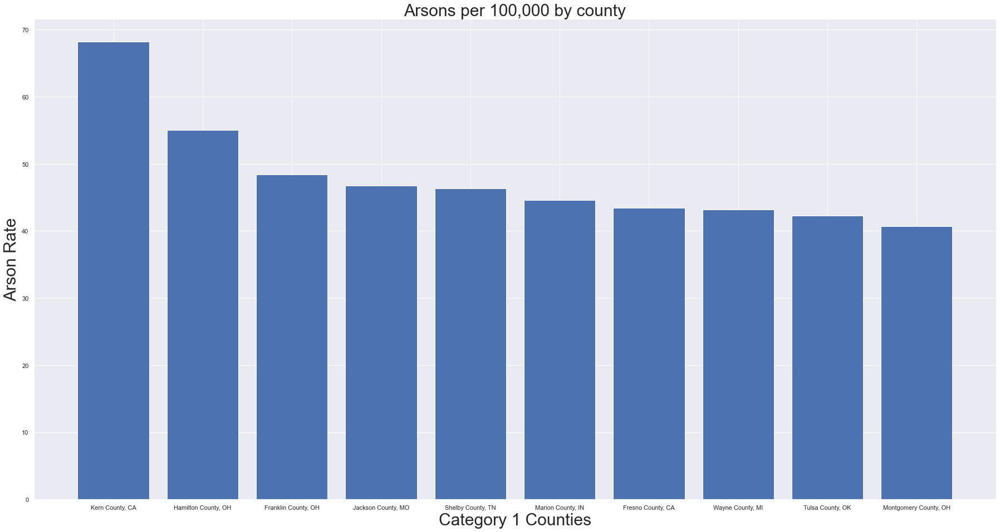

In [174]:
t = arson.iloc[:10, -10:]

X = t.index
y = t['ARSON_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,4,3])
ax.bar(X,y)

plt.title('Arsons per 100,000 by county', fontsize=30)
plt.xlabel('Category 1 Counties', fontsize=30)
plt.ylabel('Arson Rate', fontsize=30)

plt.show()

In [175]:
rape = cat_1.sort_values(by=['RAPE_RATE'], ascending=False)
rape2 = cat_2.sort_values(by=['RAPE_RATE'], ascending=False)
rape3 = cat_3.sort_values(by=['RAPE_RATE'], ascending=False)
rape4 = cat_4.sort_values(by=['RAPE_RATE'], ascending=False)

rape4

,crime_rate_per_100000,index,EDITION,PART,IDNO,CPOPARST,CPOPCRIM,AG_ARRST,AG_OFF,COVIND,INDEX,MODINDX,MURDER,MURDER_RATE,RAPE,RAPE_RATE,ROBBERY,ROBBERY_RATE,AGASSLT,AGASSLT_RATE,BURGLRY,BURGLRY_RATE,LARCENY,LARCENY_RATE,MVTHEFT,MVTHEFT_RATE,ARSON,ARSON_RATE,population,Population Category,FIPS_ST,FIPS_CTY
county_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"Kenedy County, TX",1456.310680,4,1,4,2681,444,444,1,1,100.0000,6,13,0,0.000000,3,728.155340,1,242.718447,2,485.436893,5,1213.592233,4,970.873786,4,970.873786,0,0.000000,412,Cat 4,48,261
"Dillingham Census Area, AK",938.123753,31,1,4,74,3268,2419,2,1,100.0000,47,74,0,0.000000,18,359.281437,1,19.960080,28,558.882236,12,239.520958,55,1097.804391,7,139.720559,0,0.000000,5010,Cat 4,2,70
"Northwest Arctic Borough, AK",1014.964216,21,1,4,85,3334,3334,1,1,100.0000,78,210,0,0.000000,23,299.284320,12,156.148341,43,559.531555,46,598.568640,126,1639.557580,38,494.469746,2,26.024723,7685,Cat 4,2,188
"Cass County, MN",371.213448,602,1,4,1337,28572,28572,1,1,100.0000,106,1059,3,10.506041,84,294.169147,1,3.502014,18,63.036246,216,756.434950,785,2749.080721,58,203.116792,2,7.004027,28555,Cat 4,27,21
"Alpine County, CA",690.250216,99,1,4,189,1112,1112,2,2,100.0000,8,43,0,0.000000,3,258.843831,0,0.000000,5,431.406385,18,1553.062985,20,1725.625539,5,431.406385,0,0.000000,1159,Cat 4,6,3
"Schoolcraft County, MI",424.396750,446,1,4,1319,8496,8496,3,3,36.4878,35,218,0,0.000000,15,181.884322,1,12.125621,19,230.386807,71,860.919122,143,1733.963866,4,48.502486,3,36.376864,8247,Cat 4,26,153
"Nolan County, TX",871.184412,43,1,4,2727,15498,15498,4,4,100.0000,131,507,0,0.000000,27,179.557093,10,66.502627,94,625.124692,143,950.987564,345,2294.340626,19,126.354991,1,6.650263,15037,Cat 4,48,353
"Storey County, NV",1217.656012,9,1,4,1778,3947,3947,1,1,100.0000,48,86,0,0.000000,7,177.574835,2,50.735667,39,989.345510,23,583.460173,55,1395.230847,8,202.942669,2,50.735667,3942,Cat 4,32,29
"Kalkaska County, MI",255.873459,1115,1,4,1282,17172,16367,4,3,100.0000,44,486,0,0.000000,28,162.828565,1,5.815306,15,87.229588,161,936.264247,308,1791.114213,17,98.860200,2,11.630612,17196,Cat 4,26,79


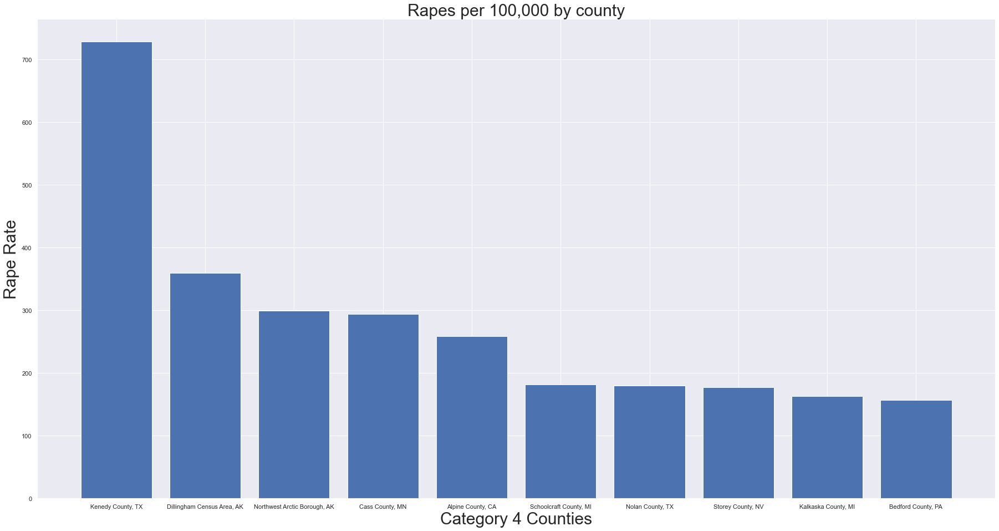

In [176]:
t = rape4.iloc[:10, -18:]

X = t.index
y = t['RAPE_RATE']
fig = plt.figure()
ax = fig.add_axes([0,0,4,3])
ax.bar(X,y)

plt.title('Rapes per 100,000 by county', fontsize=30)
plt.xlabel('Category 4 Counties', fontsize=30)
plt.ylabel('Rape Rate', fontsize=30)

plt.show()

In [177]:
def cat_rates(v, crime):
    pop = 0
    c = 0
    for i in range(len(v)):
        
        pop = pop + v['population'][i]
        
        c = c + v[crime][i]
        
    rate = c/pop*100_000

    return rate

In [178]:

print('Murder')
print(cat_rates(cat_1, 'MURDER'))
print(cat_rates(cat_2, 'MURDER'))
print(cat_rates(cat_3, 'MURDER'))
print(cat_rates(cat_4, 'MURDER'))
print('Rape')
print(cat_rates(cat_1, 'RAPE'))
print(cat_rates(cat_2, 'RAPE'))
print(cat_rates(cat_3, 'RAPE'))
print(cat_rates(cat_4, 'RAPE'))
print('Robbery')
print(cat_rates(cat_1, 'ROBBERY'))
print(cat_rates(cat_2, 'ROBBERY'))
print(cat_rates(cat_3, 'ROBBERY'))
print(cat_rates(cat_4, 'ROBBERY'))
print('Agasslt')
print(cat_rates(cat_1, 'AGASSLT'))
print(cat_rates(cat_2, 'AGASSLT'))
print(cat_rates(cat_3, 'AGASSLT'))
print(cat_rates(cat_4, 'AGASSLT'))
print('Burglry')
print(cat_rates(cat_1, 'BURGLRY'))
print(cat_rates(cat_2, 'BURGLRY'))
print(cat_rates(cat_3, 'BURGLRY'))
print(cat_rates(cat_4, 'BURGLRY'))
print('Larceny')
print(cat_rates(cat_1, 'LARCENY'))
print(cat_rates(cat_2, 'LARCENY'))
print(cat_rates(cat_3, 'LARCENY'))
print(cat_rates(cat_4, 'LARCENY'))
print('Mvtheft')
print(cat_rates(cat_1, 'MVTHEFT'))
print(cat_rates(cat_2, 'MVTHEFT'))
print(cat_rates(cat_3, 'MVTHEFT'))
print(cat_rates(cat_4, 'MVTHEFT'))
print('Arson')
print(cat_rates(cat_1, 'ARSON'))
print(cat_rates(cat_2, 'ARSON'))
print(cat_rates(cat_3, 'ARSON'))
print(cat_rates(cat_4, 'ARSON'))

Murder
5.675006533879583
4.107778521852581
3.211002820796174
3.02357547332175
Rape
24.65821088948439
28.64560660423618
27.322915306934945
24.968080550632315
Robbery
167.91908600022276
79.75683709384496
39.07209954138136
22.67929845998974
Agasslt
270.14248015280305
221.25489358085457
193.05695220503128
177.56431037046917
Burglry
671.4872643504078
673.1597196701231
663.4394741215032
550.3130778352481
Larceny
2012.8699910109963
2003.3860863146936
1779.4429762454492
1381.7168958762775
Mvtheft
314.9092137329479
168.63451235786707
122.04749852042208
94.03121129224512
Arson
17.228492858733116
17.667110631183036
14.901404394907644
13.174150276616196


In [179]:
y = [cat_rates(cat_1, 'MURDER'), cat_rates(cat_2, 'MURDER'), cat_rates(cat_3, 'MURDER'), cat_rates(cat_4, 'MURDER')]
x = ['Cat 1', 'Cat_2', 'Cat_3', 'Cat_4']
y2 = [cat_rates(cat_1, 'RAPE'), cat_rates(cat_2, 'RAPE'), cat_rates(cat_3, 'RAPE'), cat_rates(cat_4, 'RAPE')]
y3 = [cat_rates(cat_1, 'ROBBERY'), cat_rates(cat_2, 'ROBBERY'), cat_rates(cat_3, 'ROBBERY'), cat_rates(cat_4, 'ROBBERY')]
y4 = [cat_rates(cat_1, 'AGASSLT'), cat_rates(cat_2, 'AGASSLT'), cat_rates(cat_3, 'AGASSLT'), cat_rates(cat_4, 'AGASSLT')]
y5 = [cat_rates(cat_1, 'BURGLRY'), cat_rates(cat_2, 'BURGLRY'), cat_rates(cat_3, 'BURGLRY'), cat_rates(cat_4, 'BURGLRY')]
y6 = [cat_rates(cat_1, 'LARCENY'), cat_rates(cat_2, 'LARCENY'), cat_rates(cat_3, 'LARCENY'), cat_rates(cat_4, 'LARCENY')]
y7 = [cat_rates(cat_1, 'MVTHEFT'), cat_rates(cat_2, 'MVTHEFT'), cat_rates(cat_3, 'MVTHEFT'), cat_rates(cat_4, 'MVTHEFT')]
y8 = [cat_rates(cat_1, 'ARSON'), cat_rates(cat_2, 'ARSON'), cat_rates(cat_3, 'ARSON'), cat_rates(cat_4, 'ARSON')]


fig = go.Figure()
fig.add_trace(go.Scatter(name="Murder", mode="markers+lines", x=x, y=y))
fig.add_trace(go.Scatter(name="Rape", mode="markers+lines", x=x, y=y2))
fig.add_trace(go.Scatter(name="Robbery", mode="markers+lines", x=x, y=y3))
fig.add_trace(go.Scatter(name="Aggravated Assault", mode="markers+lines", x=x, y=y4))
fig.add_trace(go.Scatter(name="Burglary", mode="markers+lines", x=x, y=y5))
fig.add_trace(go.Scatter(name="Larceny", mode="markers+lines", x=x, y=y6))
fig.add_trace(go.Scatter(name="Motor Theft", mode="markers+lines", x=x, y=y7))
fig.add_trace(go.Scatter(name="Arson", mode="markers+lines", x=x, y=y8))
fig.update_layout(
    title="Crime Rates by Population Category",
    xaxis_title="Population Category",
    yaxis_title="Rate")